In [ ]:
%tensorflow_version 2.x
import tensorflow as tf
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

Found GPU at: /device:GPU:0


# DEEP DREAM



Dans ce notebook, nous allons tenter de répondre à la question suivante? Qu'est ce qui est appris au sein des différentes couches de ce réseau convolutif qu'est VGG16? A quoi ressemble les différents 'features' qui sont appris au fur et à mesure du réseau, à fin de reconnaitre des formes et des textures de plus en plus complexes? Comment finalement, le réseau utilise ces features pour distinguer les motos, les voitures et les camions, voire même toutes les classes d'imagenet.

Pour cela, nous allons utiliser les idées de l'algorithme DeepDream, developpé par Google. L'idée est de partir d'une image aléatoire, de bruit, et, pas un gradient ascent, d'essayer de créer l'image qui maximise l'activation d'une certaine couche. Cela permettre de mieux comprendre ce qu'il se passe au niveau de cette couche.

Malheureusement, pour faire notre classification 'vehicle-recognition', nous avons entraîné nos modèles sur keras. Et l'implémentation de deep dream que nous utilisons ici utilise des modèles pytorch. La suite de ce notebook se focalise donc sur le décryptage d'un modèle VGG16 qui n'est pas celui que nous avons fine tuné, mais simplement un modèle pré-entrainé sur imagenet.

### Connexion au drive

In [ ]:
%tensorflow_version 2.x
import tensorflow as tf
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
path = '/content/drive/MyDrive/Applied Deep Learning/vehicle-recognition/data/'

## Import and functions

In [ ]:
import numpy as np
import torch
from torch.autograd import Variable
from torch.optim import SGD
from torchvision import models, transforms
import PIL
import os
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

import scipy.ndimage as ndimage

%matplotlib inline

import scipy.ndimage as nd
import PIL.Image
from IPython.display import clear_output, Image, display
from io import BytesIO


def showarray(a, fmt='jpeg'):
    a = np.uint8(np.clip(a, 0, 255))
    f = BytesIO()
    PIL.Image.fromarray(a).save(f, fmt)
    display(Image(data=f.getvalue()))
    
def showtensor(a):
    mean = np.array([0.485, 0.456, 0.406]).reshape([1, 1, 3])
    std = np.array([0.229, 0.224, 0.225]).reshape([1, 1, 3])
    inp = a[0, :, :, :]
    inp = inp.transpose(1, 2, 0)
    inp = std * inp + mean
    inp *= 255
    showarray(inp)
    clear_output(wait=True)

def plot_images(im, titles=None):
    plt.figure(figsize=(30, 20))
    
    for i in range(len(im)):
        plt.subplot(10 / 5 + 1, 5, i + 1)
        plt.axis('off')
        if titles is not None:
            plt.title(titles[i])
        plt.imshow(im[i])
        
    plt.pause(0.001)
    
normalise = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

normalise_resize = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

def init_image(size=(400, 400, 3)):
    img = PIL.Image.fromarray(np.uint8(np.full(size, 150)))
    img = PIL.Image.fromarray(np.uint8(np.random.uniform(150, 180, size)))
    img_tensor = normalise(img).unsqueeze(0)
    img_np = img_tensor.numpy()
    return img, img_tensor, img_np

def load_image(path, resize=False, size=None):
    img = PIL.Image.open(path)
    
    if size is not None:
        img.thumbnail(size, PIL.Image.ANTIALIAS)
        
    if resize:
        img_tensor = normalise_resize(img).unsqueeze(0)
    else:
        img_tensor = normalise(img).unsqueeze(0)
    img_np = img_tensor.numpy()
    return img, img_tensor, img_np

def tensor_to_img(t):
    a = t.numpy()
    mean = np.array([0.485, 0.456, 0.406]).reshape([1, 1, 3])
    std = np.array([0.229, 0.224, 0.225]).reshape([1, 1, 3])
    inp = a[0, :, :, :]
    inp = inp.transpose(1, 2, 0)
    inp = std * inp + mean
    inp *= 255
    inp = np.uint8(np.clip(inp, 0, 255))
    return PIL.Image.fromarray(inp)

def image_to_variable(image, requires_grad=False, cuda=False):
    if cuda:
        image = Variable(image.cuda(), requires_grad=requires_grad)
    else:
        image = Variable(image, requires_grad=requires_grad)
    return image

Le modèle utilisé à été télécharger sur le Kaggle suivant : https://www.kaggle.com/code/carloalbertobarbano/convolutional-network-visualizations-deep-dream/notebook.

Ce modèle a été entrainé sur imagenet afin de distinguer 1000 classes, et non pas seulement les 3 classes qui nous intéressent, à savoir les camions, les motos et les voitures. 

Le dataset imagenet comporte un bon nombre d'animaux, notamment de chiens de race différentes. Nous ne serons donc pas surpris si des formes ressemblant à des animaux apparaissent quand nous tenterons de comprendre en détail ce qu'il se passe à l'intérieur des couches.

In [ ]:
model = models.vgg16()
model.load_state_dict(torch.load(path+"/vgg16.pth"))

<All keys matched successfully>

In [ ]:
use_gpu = False
if torch.cuda.is_available():
    use_gpu = True

print(model)

for param in model.parameters():
    param.requires_grad = False

if use_gpu:
    print("Using CUDA")
    model.cuda()

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

La fonction octaver est utilisée pour produire de meilleures images de sortie. Cette procédure est tirée du code de Deep Dream. Nous l'utiliserons non seulement pour l'algorithme Deep Dream, mais aussi pour visualiser les filtres. L'algorithme d'ascension de gradient est exécuté sur plusieurs versions réduites de l'image, et les résultats sont mis à l'échelle et fusionnés ensemble pour obtenir l'image finale.

In [ ]:
def octaver_fn(model, base_img, step_fn, octave_n=6, octave_scale=1.4, iter_n=10, **step_args):
    octaves = [base_img]
    
    for i in range(octave_n - 1):
        octaves.append(nd.zoom(octaves[-1], (1, 1, 1.0 / octave_scale, 1.0 / octave_scale), order=1))

    detail = np.zeros_like(octaves[-1])
    for octave, octave_base in enumerate(octaves[::-1]):
        h, w = octave_base.shape[-2:]
        
        if octave > 0:
            h1, w1 = detail.shape[-2:]
            detail = nd.zoom(detail, (1, 1, 1.0 * h / h1, 1.0 * w / w1), order=1)
        
        src = octave_base + detail
        
        for i in range(iter_n):
            src = step_fn(model, src, **step_args)

        detail = src.numpy() - octave_base

    return src

La prochaine fonction, filter_step, produit une image qui maximise l'activation du filtre à filter_index dans la couche layer_index.



Tout cela est très simple. La seule astuce consiste à normaliser le gradient des pixels de l'image d'entrée, ce qui permet d'éviter les gradients très petits et très grands et assure un processus de gradient ascent stable.

In [ ]:
def filter_step(model, img, layer_index, filter_index, step_size=5, display=True, use_L2=False):
    global use_gpu
    
    mean = np.array([0.485, 0.456, 0.406]).reshape([3, 1, 1])
    std = np.array([0.229, 0.224, 0.225]).reshape([3, 1, 1])
    
    model.zero_grad()
    
    img_var = image_to_variable(torch.Tensor(img), requires_grad=True, cuda=use_gpu)
    optimizer = SGD([img_var], lr=step_size, weight_decay=1e-4)
    
    x = img_var
    for index, layer in enumerate(model.features):
        x = layer(x)
        if index == layer_index:
            break

    output = x[0, filter_index]
    loss = output.norm() #torch.mean(output)
    loss.backward()
    
    if use_L2:
        #L2 normalization on gradients
        mean_square = torch.Tensor([torch.mean(img_var.grad.data ** 2) + 1e-5])
        if use_gpu:
            mean_square = mean_square.cuda()
        img_var.grad.data /= torch.sqrt(mean_square)
        img_var.data.add_(img_var.grad.data * step_size)
    else:
        optimizer.step()
    
    result = img_var.data.cpu().numpy()
    result[0, :, :, :] = np.clip(result[0, :, :, :], -mean / std, (1 - mean) / std)
    
    if display:
        showtensor(result)
    
    return torch.Tensor(result)

def visualize_filter(model, base_img, layer_index, filter_index, 
                     octave_n=6, octave_scale=1.4, iter_n=10, 
                     step_size=5, display=True, use_L2=False):
    
    return octaver_fn(
                model, base_img, step_fn=filter_step, 
                octave_n=octave_n, octave_scale=octave_scale, 
                iter_n=iter_n, layer_index=layer_index, 
                filter_index=filter_index, step_size=step_size, 
                display=display, use_L2=use_L2
            )

In [ ]:
def show_layer(layer_num, filter_start=10, filter_end=20, step_size=7, use_L2=False):
    filters = []
    titles = []
    
    _, _, img_np = init_image(size=(600, 600, 3))
    for i in range(filter_start, filter_end):
        title = "Layer {} Filter {}".format(layer_num , i)
        print(title)
        filter = visualize_filter(model, img_np, layer_num, filter_index=i, octave_n=2, iter_n=20, step_size=step_size, display=True, use_L2=use_L2)
        filter_img = tensor_to_img(filter)
        filter_img.save(title + ".jpg")
        filters.append(tensor_to_img(filter))
        titles.append(title)
        
    
    plot_images(filters, titles)
    return filters, titles

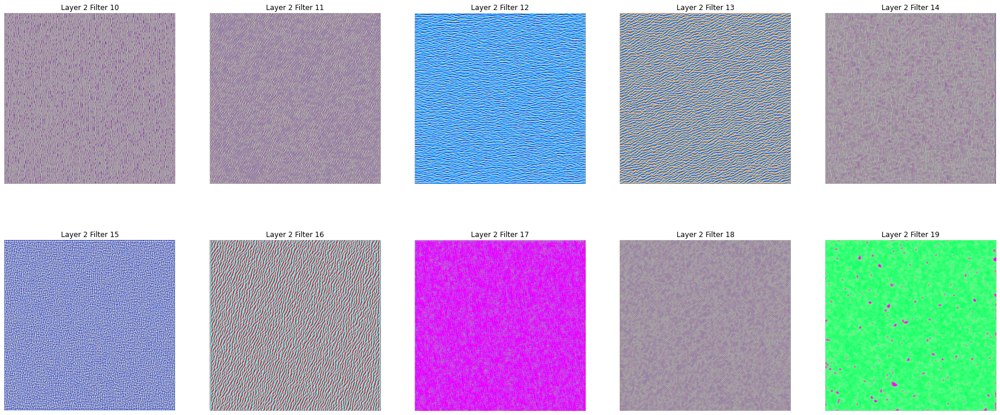

In [ ]:
images, titles = show_layer(2, use_L2=True, step_size=0.05)

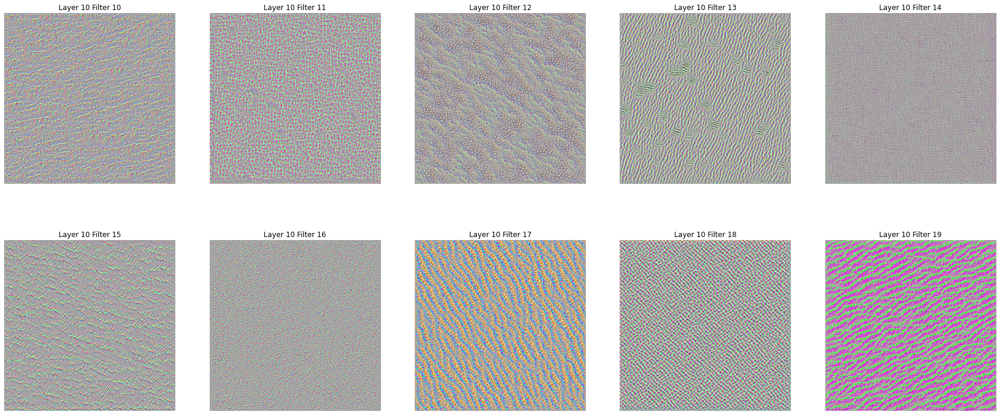

In [ ]:
images, titles = show_layer(10, use_L2=True, step_size=0.05)

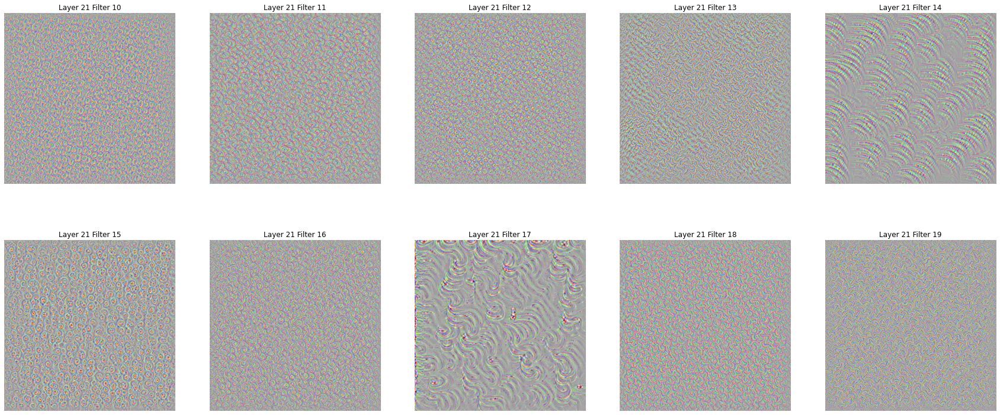

In [ ]:
images, titles = show_layer(21, use_L2=True, step_size=0.05)

BILAN : Les premières couches ne font que coder la direction et la couleur. Ces filtres de direction et de couleur sont ensuite combinés en textures de base de grille et de points. Ces textures se combinent progressivement pour former des motifs de plus en plus complexes.


Nous pouvons aussi observer que beaucoup de ces filtres sont similaires et diffèrent d'une simple rotation. Cela est dû au fait que les filtres convolutionnels ne sont pas invariants par rotation. 

## The DeepDream algorithm

La fonction Deep Dream est similaire à la visualisation du filtre de la partie précédente. Cependant, au lieu de partir d'une image de bruit aléatoire, nous partons d'une image réelle et essayons de maximiser la sortie du réseau. De cette façon, nous améliorons les caractéristiques que le réseau reconnaît dans l'image. Les couches inférieures ont tendance à produire des motifs géométriques et des textures, tandis que les couches supérieures produisent des formes plus abstraites qui ressemblent à ce que le réseau a vu pendant son processus de formation

In [ ]:
def objective(dst, guide_features):
    if guide_features is None:
        return dst.data
    else:
        x = dst.data[0].cpu().numpy()
        y = guide_features.data[0].cpu().numpy()
        ch, w, h = x.shape
        x = x.reshape(ch, -1)
        y = y.reshape(ch, -1)
        A = x.T.dot(y)
        diff = y[:, A.argmax(1)]
        diff = torch.Tensor(np.array([diff.reshape(ch, w, h)])).cuda()
        return diff

def make_step(model, img, objective=objective, control=None, step_size=1.5, end=28, jitter=32):
    global use_gpu
    
    mean = np.array([0.485, 0.456, 0.406]).reshape([3, 1, 1])
    std = np.array([0.229, 0.224, 0.225]).reshape([3, 1, 1])
    
    ox, oy = np.random.randint(-jitter, jitter+1, 2)
    
    img = np.roll(np.roll(img, ox, -1), oy, -2)
    tensor = torch.Tensor(img) 
    
    img_var = image_to_variable(tensor, requires_grad=True, cuda=use_gpu)
    model.zero_grad()
      
    x = img_var
    for index, layer in enumerate(model.features.children()):
        x = layer(x)
        if index == end:
            break
    
    delta = objective(x, control)
    x.backward(delta)
    
    #L2 Regularization on gradients
    mean_square = torch.Tensor([torch.mean(img_var.grad.data ** 2)])
    if use_gpu:
        mean_square = mean_square.cuda()
    img_var.grad.data /= torch.sqrt(mean_square)
    img_var.data.add_(img_var.grad.data * step_size)
    
    result = img_var.data.cpu().numpy()
    result = np.roll(np.roll(result, -ox, -1), -oy, -2)
    result[0, :, :, :] = np.clip(result[0, :, :, :], -mean / std, (1 - mean) / std)
    showtensor(result)
    
    return torch.Tensor(result)
                                                             
def deepdream(model, base_img, octave_n=6, octave_scale=1.4, 
              iter_n=10, end=28, control=None, objective=objective, 
              step_size=1.5, jitter=32):
    
    return octaver_fn(
              model, base_img, step_fn=make_step, 
              octave_n=octave_n, octave_scale=octave_scale, 
              iter_n=iter_n, end=end, control=control,
              objective=objective, step_size=step_size, jitter=jitter
           )

(1024, 768)


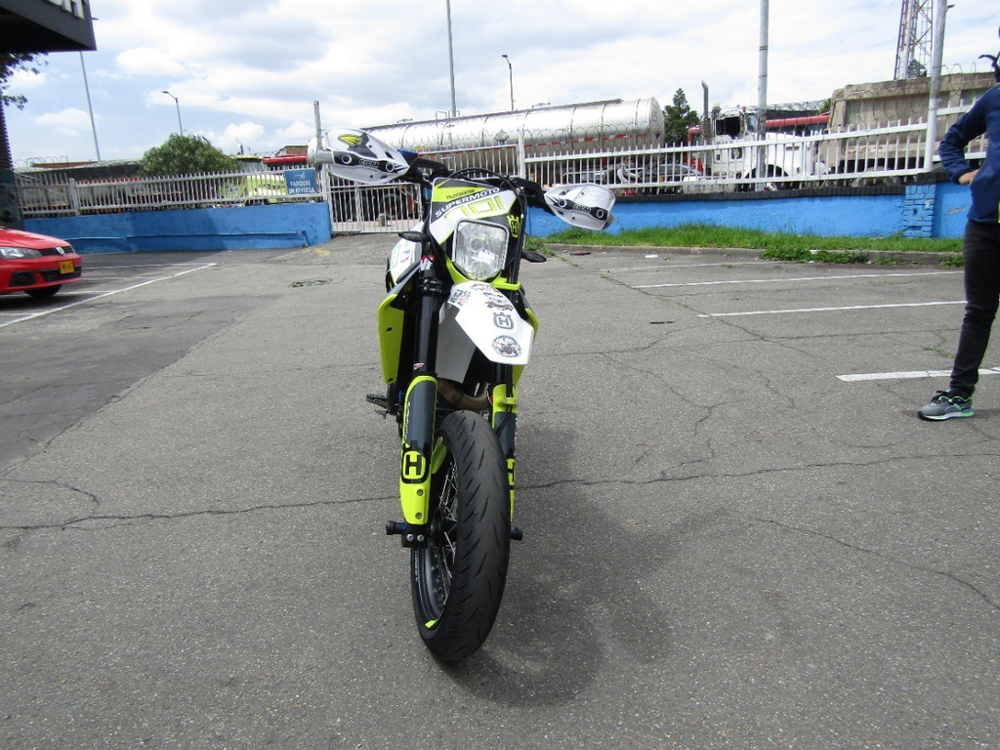

In [ ]:
input_path = '/content/drive/MyDrive/Applied Deep Learning/vehicle-recognition/data/train/motos/2.jpg'
input_img, input_tensor, input_np = load_image(input_path, size=[1024, 1024])
print(input_img.size)
input_img

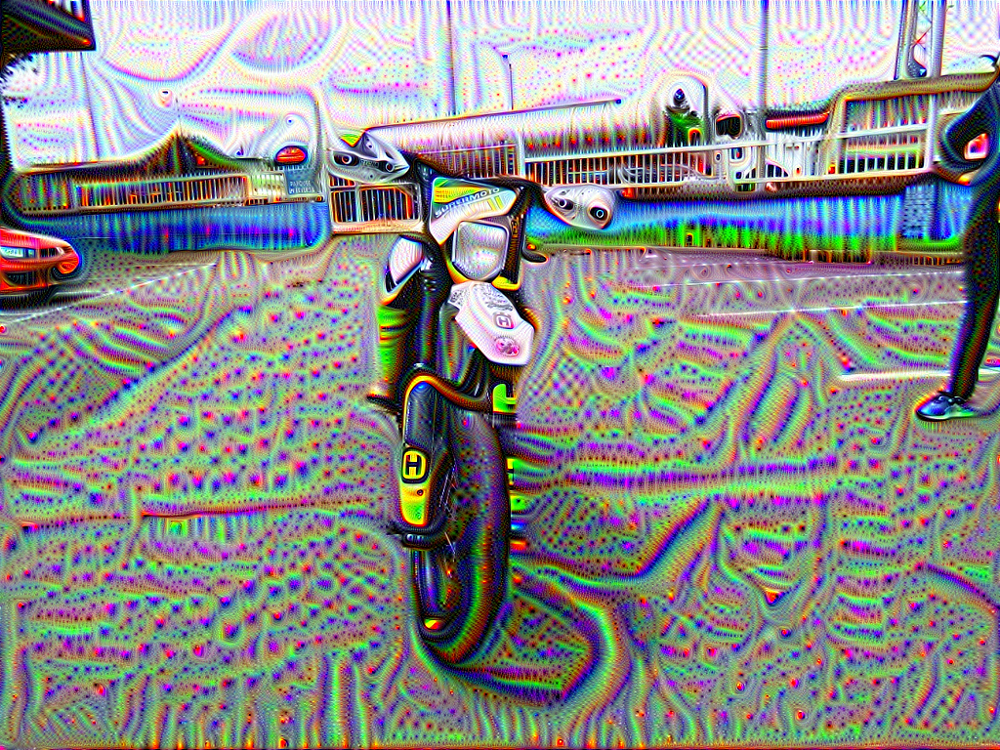

In [ ]:
dream = deepdream(model, input_np, end=14, step_size=0.06, octave_n=6)
dream = tensor_to_img(dream)
dream.save('dream00.jpg')
dream

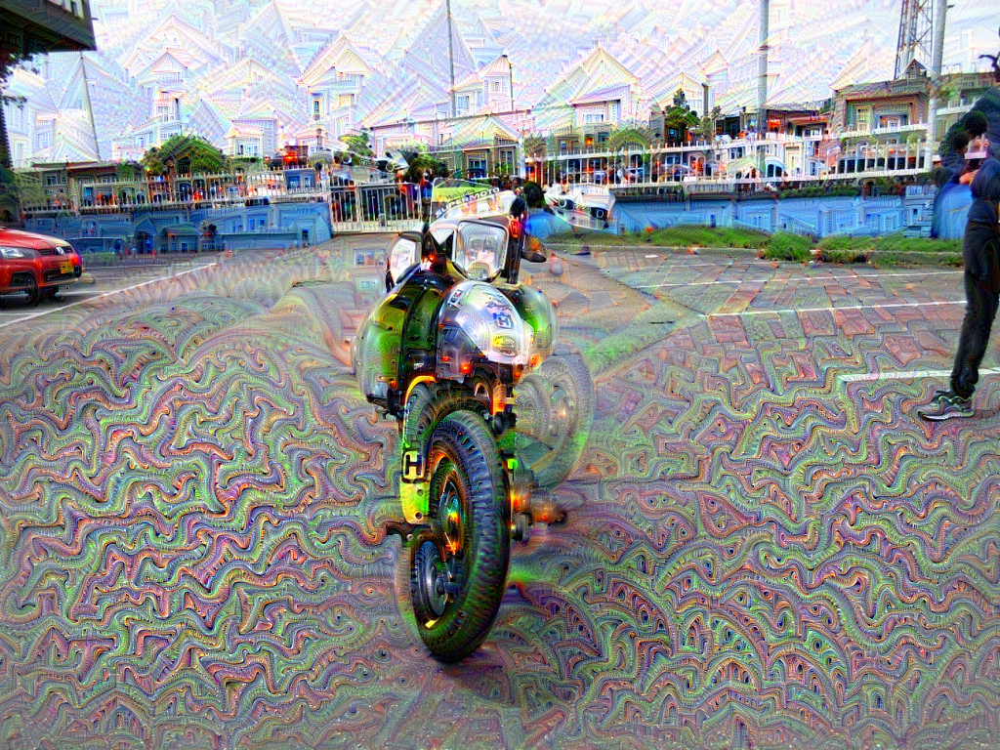

In [ ]:
dream = deepdream(model, input_np, end=28, step_size=0.06, octave_n=6)
dream = tensor_to_img(dream)
dream.save('dream03.jpg')
dream

Nous pouvons voir des voir des formes dans l'arrière plan qui ressemblent au toit d'une maison, et des textures qui peuvent faire penser à des animaux sur le sol.

Nous pouvons aussi contrôler le DeepDream en essayant de modifier l'image afin de maximiser les filtres qui sont activés par une autre image (que nous appellerons guide_img)

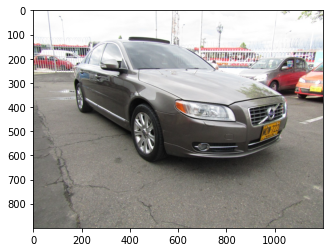

In [ ]:
guide_img_path = '/content/drive/MyDrive/Applied Deep Learning/vehicle-recognition/data/train/cars/2.jpg'
guide_img, guide_img_tensor, guide_img_np = load_image(guide_img_path, resize=True)
plt.imshow(guide_img)

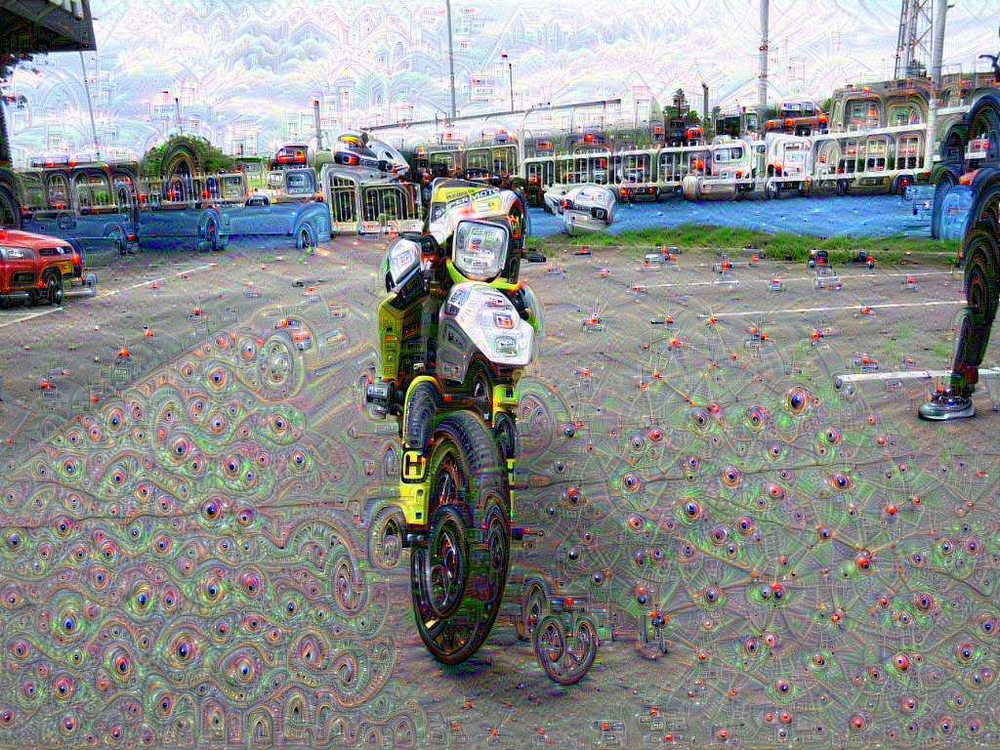

In [ ]:
end = 26

guide_features = image_to_variable(guide_img_tensor, cuda=use_gpu)

for index, layer in enumerate(model.features.children()):
    guide_features = layer(guide_features)
    if index == end:
        break
    
dream = deepdream(model, input_np, end=end, step_size=0.06, octave_n=4, control=guide_features)
dream = tensor_to_img(dream)
dream.save('dream04.jpg')
dream

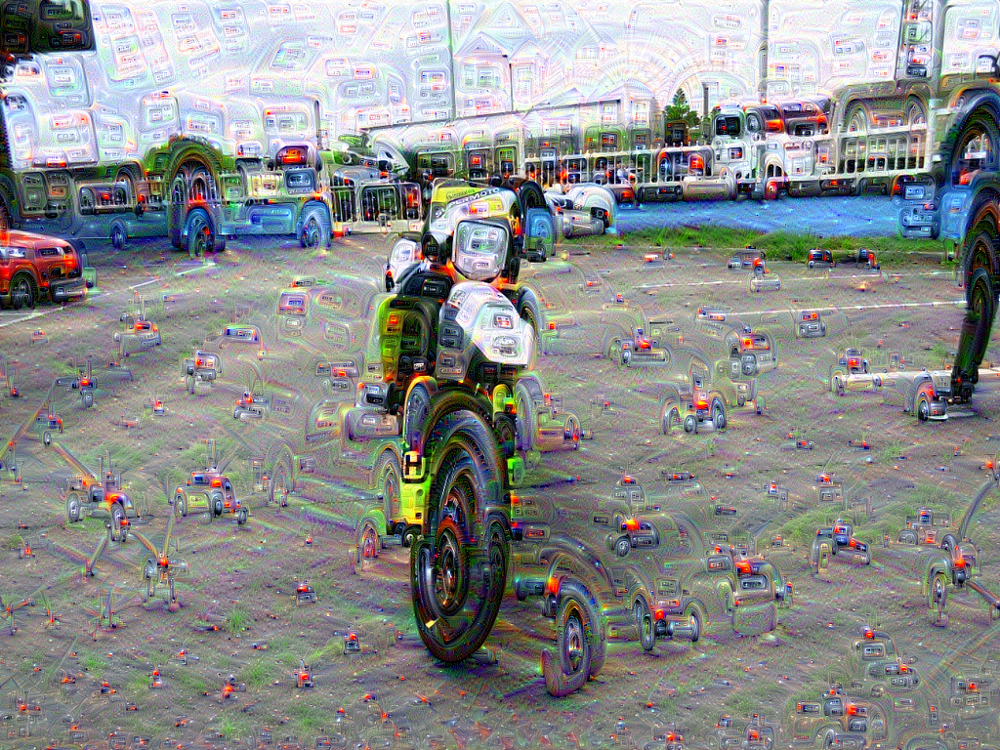

In [ ]:
dream = deepdream(model, input_np, end=26, step_size=0.06, octave_n=6, control=guide_features)
dream = tensor_to_img(dream)
#dream.save('dream05.jpg')
dream

Ici, nous voyons ainsi des formes de voiture se former sur notre image de moto.

(700, 466)


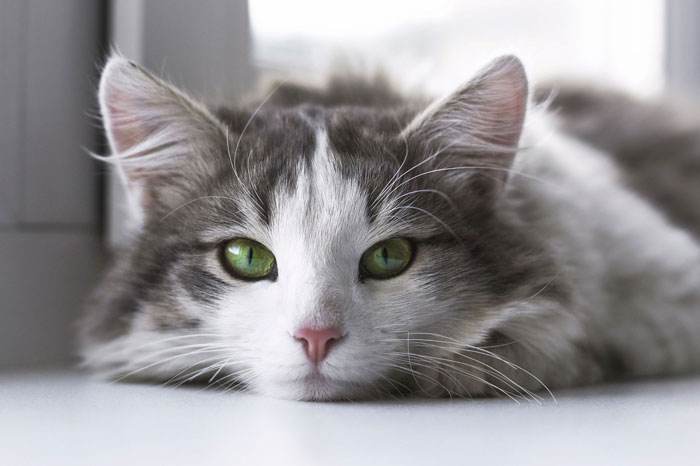

In [ ]:
input_path = '/content/drive/MyDrive/Applied Deep Learning/vehicle-recognition/data/chat.jpg'
input_img, input_tensor, input_np = load_image(input_path, size=[1024, 1024])
print(input_img.size)
input_img

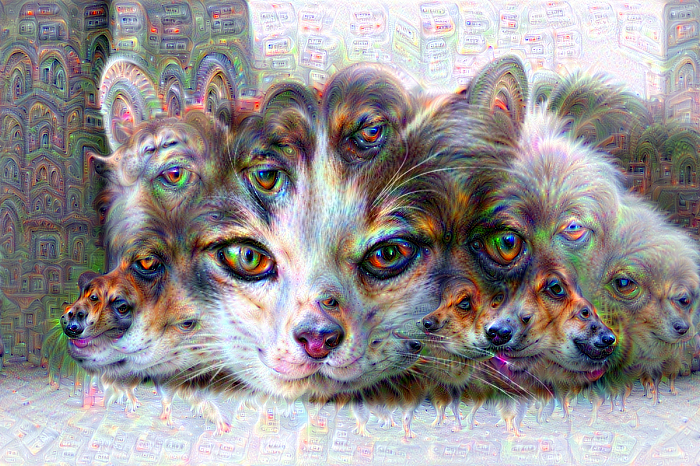

In [ ]:
end = 26

guide_features = image_to_variable(guide_img_tensor, cuda=use_gpu)

for index, layer in enumerate(model.features.children()):
    guide_features = layer(guide_features)
    if index == end:
        break
    
dream = deepdream(model, input_np, end=end, step_size=0.06, octave_n=4, control=guide_features)
dream = tensor_to_img(dream)
dream.save('dream04.jpg')
dream

dream = deepdream(model, input_np, end=26, step_size=0.06, octave_n=6, control=guide_features)
dream = tensor_to_img(dream)
dream

Sur cette image de chat, on voit aussi des formes de voiture se former, avec notamment des roues en haut de l'image. 

Mais ce sont surtout des images d'autres animaux (notamment des chiens) que l'on voit apparaitre. Cela est dû au fait que, comme nous l'avions précisé en introduction, ce VGG16 a été entrainé sur imagenet, et donc spécifiquement entrainé pour reconnaitre des formes de chiens. 

SOURCE : https://www.kaggle.com/code/carloalbertobarbano/convolutional-network-visualizations-deep-dream/notebook